In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = "iframe"  

In [2]:
network_path = os.path.join("networks", "striatum_with_dopamine_dspn")
network_file = os.path.join(network_path, "network-synapses.hdf5")
simulation_file = os.path.join(network_path, "simulation", "output_DA_sim.hdf5")

Loading networks/striatum_with_dopamine_dspn/simulation/output_DA_sim.hdf5
WARNING. Depolarisation block in neuron - neuron_id: (name, parameter_key, morphology_key):
35: (dSPN_1, p9faf904a, mc44c4566)
60: (dSPN_1, pe8a7f1ac, m82894e90)
Saving figure to networks/striatum_with_dopamine_dspn/figures/spike-raster.png


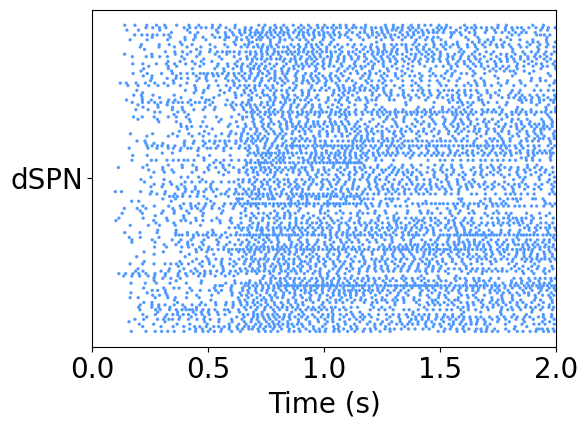

In [3]:
from snudda.plotting import SnuddaPlotSpikeRaster2
fig_file_raster = f"spike-raster.png"

from snudda.utils.load import SnuddaLoad
from snudda.utils.load_network_simulation import SnuddaLoadSimulation

sl = SnuddaLoad(network_file)
sls = SnuddaLoadSimulation(network_path=network_path,
                           network_simulation_output_file=simulation_file)

spr = SnuddaPlotSpikeRaster2(network_path=network_path,
                             network_file=network_file,
                             simulation_file=simulation_file,
                             snudda_load=sl, snudda_simulation_load=sls)

spr.plot_spike_raster(fig_file=fig_file_raster, sort_direction="x")

Writing figure networks/striatum_with_dopamine_dspn/figures/spike-histogram.svg


/home/hjorth/HBP/Snudda/snudda/plotting/plot_spike_raster_v2.py:350: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



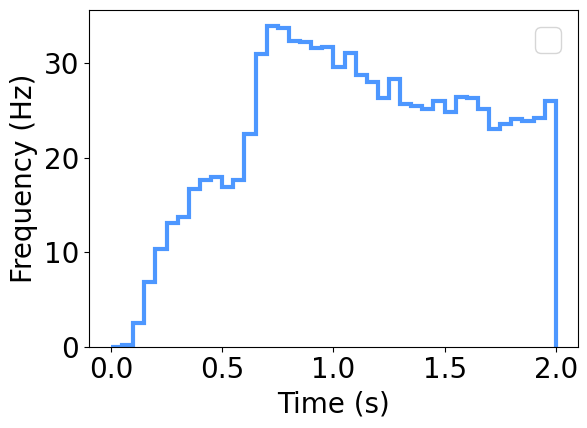

<Axes: xlabel='Time (s)', ylabel='Frequency (Hz)'>

In [4]:
spr.plot_spike_histogram_type(neuron_type=["dSPN"], fig_file="spike-histogram.svg")

In [5]:
from snudda.plotting.plot_simulation_reaction_diffusion import PlotReactionDiffusion

# By passing the sls object we avoid loading it twice
prd = PlotReactionDiffusion(network_path=network_path,
                            simulation_file=simulation_file,
                            snudda_simulation=sls)

for i in [0,1,2,3]:
    print(f"Neuron {i} has data: {prd.list_neuron_info(i)}\n\n")

Neuron 0 has data: ['AC5', 'AC5_ATP', 'AC5_Ca', 'AC5_Ca_ATP', 'AC5_Ca_GaolfGTP', 'AC5_Ca_GaolfGTP_ATP', 'AC5_GaolfGTP', 'AC5_GaolfGTP_ATP', 'AMP', 'ARPP21', 'ATP', 'B56PP2A', 'B56PP2A_D32p75', 'B56PP2A_pARPP21', 'B56PP2Ap', 'B56PP2Ap_D32p75', 'B56PP2Ap_pARPP21', 'B72PP2A', 'B72PP2A_Ca', 'B72PP2A_Ca_D32p34', 'B72PP2A_Ca_D32p75', 'B72PP2A_Ca_pARPP21', 'B72PP2A_D32p34', 'B72PP2A_D32p75', 'B72PP2A_pARPP21', 'CDK5', 'CDK5_D32', 'Ca', 'CaM', 'CaMKII', 'CaMKII_CaM', 'CaMKII_CaM_Ca2', 'CaMKII_CaM_Ca2_psd', 'CaMKII_CaM_Ca2_psd_Substrate', 'CaMKII_CaM_Ca4', 'CaMKII_CaM_Ca4_CaMKII_CaM_Ca4', 'CaMKII_CaM_Ca4_psd', 'CaMKII_CaM_Ca4_psd_CaMKII_CaM_Ca4_psd', 'CaMKII_CaM_Ca4_psd_Substrate', 'CaMKII_CaM_psd', 'CaMKII_CaM_psd_Substrate', 'CaMKII_psd', 'CaM_Ca2', 'CaM_Ca4', 'CaM_Ca4_pARPP21', 'D1R', 'D1R_DA', 'D1R_Golf', 'D1R_Golf_DA', 'D32', 'D32p34', 'D32p75', 'DA', 'GaolfGDP', 'GaolfGTP', 'Gbgolf', 'Golf', 'PDE10c', 'PDE10c_cAMP', 'PDE10r', 'PDE10r_cAMP', 'PDE4', 'PDE4_cAMP', 'PKA', 'PKA_Ca2MP', 'PKA_Ca

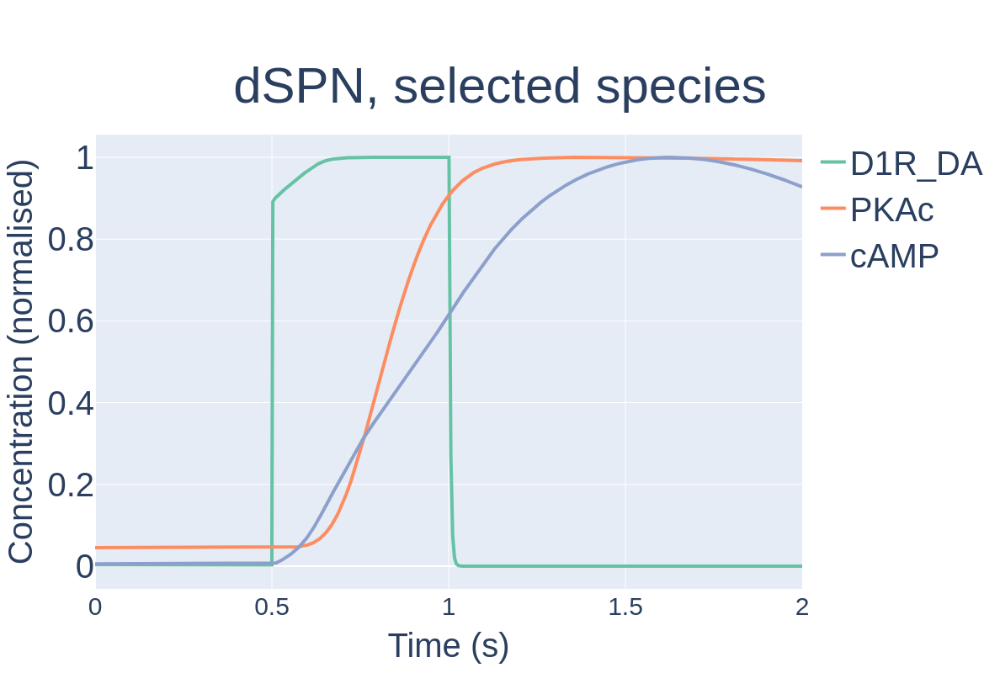

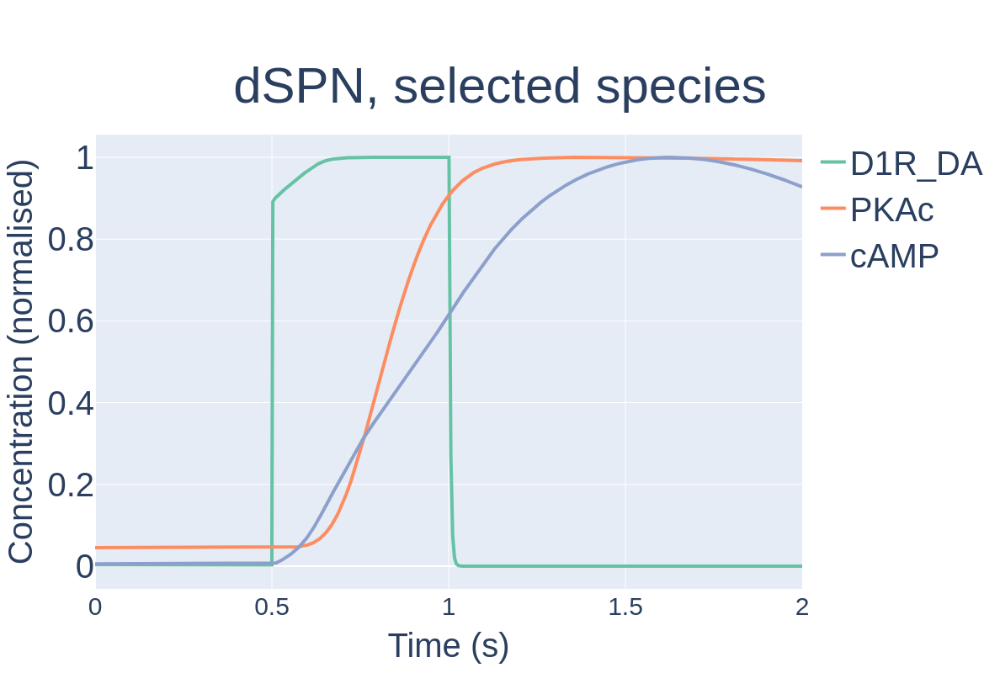

In [6]:
prd.plot(neuron_id=0, species=["D1R_DA", "PKAc", "cAMP"], fig_name="biochem-0-normalised.svg", title="dSPN, selected species", normalise=True)

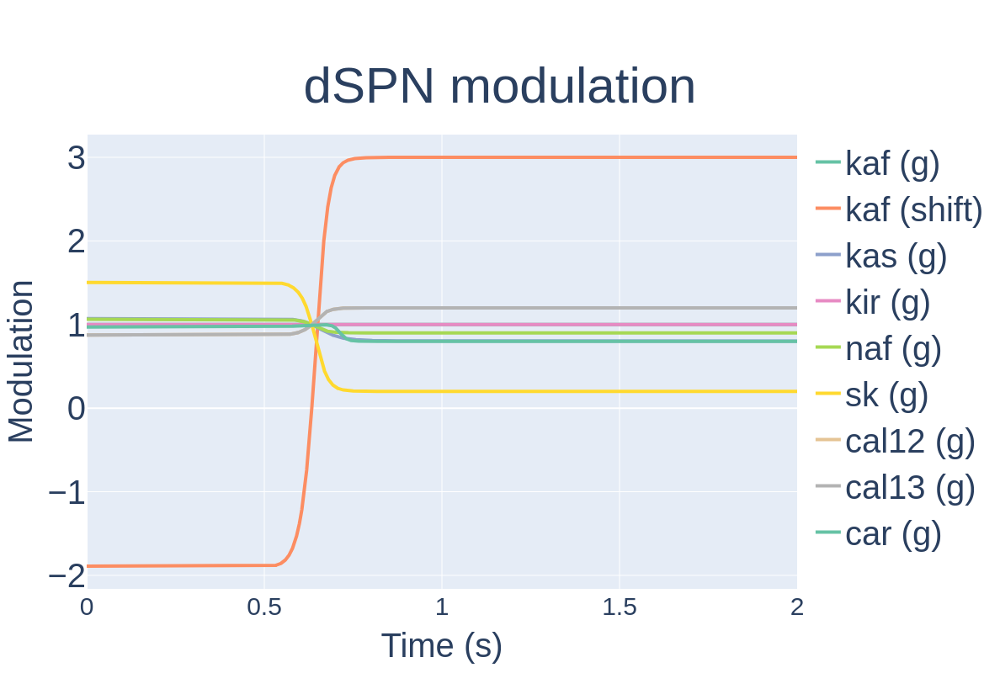

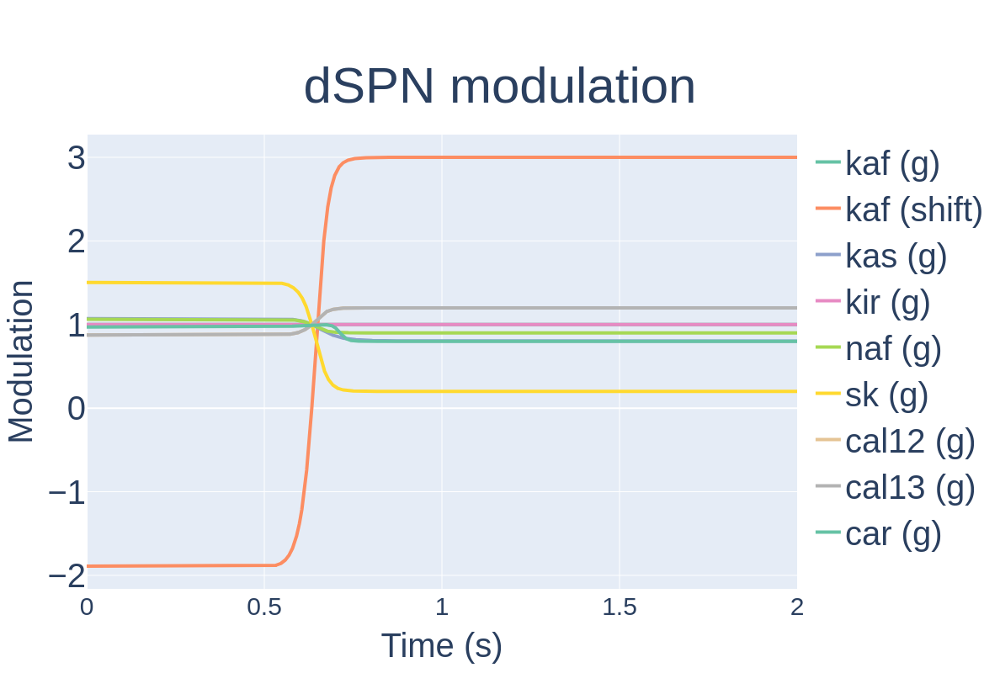

In [7]:
prd.plot(neuron_id=0, 
         species=['kaf_ms.modulation_factor_g', 'kaf_ms.modulation_factor_shift', 'kas_ms.modulation_factor', 'kir_ms.modulation_factor', 'naf_ms.modulation_factor',
                 'sk_ms.modulation_factor', 'cal12_ms.modulation_factor', 'cal13_ms.modulation_factor', 'car_ms.modulation_factor'], 
         species_label=['kaf (g)', 'kaf (shift)', 'kas (g)', 'kir (g)', 'naf (g)', 'sk (g)', 'cal12 (g)', 'cal13 (g)', 'car (g)'],
         ylabel="Modulation", fig_name="modulation-0.svg", title="dSPN modulation", width=800, height=700)